# Enhancing Customer Engagement: 

Clustering: The primary objective of clustering is to group similar data points together based on certain features or characteristics. Clusters are formed to maximize the intra-cluster similarity and minimize the inter-cluster similarity.
Segmentation: Segmentation is more business-oriented and aims to identify groups of customers or market segments that share similar behaviors, needs, or characteristics. It is often used in marketing and customer analysis to tailor strategies for different segments.

# Inporting Necessary Libraries

In [1]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px 
import plotly.graph_objects as go 

# Importing Dataset

In [3]:
df = pd.read_csv("customer_data_credit_card.csv")

# Explorarory Data Analysis

In [4]:
df.head()

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,C10001,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,C10002,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,C10003,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.000000,12
4,C10005,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12


In [5]:
df.tail()

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
8945,C19186,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,325.594462,48.886365,0.50,6
8946,C19187,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,275.861322,NaN,0.00,6
8947,C19188,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0,5,1000.0,81.270775,82.418369,0.25,6
8948,C19189,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2,0,500.0,52.549959,55.755628,0.25,6
8949,C19190,372.708075,0.666667,1093.25,1093.25,0.00,127.040008,0.666667,0.666667,0.000000,0.333333,2,23,1200.0,63.165404,88.288956,0.00,6


In [6]:
df.shape

(8950, 18)

In [7]:
df.columns

Index(['CUST_ID', 'BALANCE', 'BALANCE_FREQUENCY', 'PURCHASES',
       'ONEOFF_PURCHASES', 'INSTALLMENTS_PURCHASES', 'CASH_ADVANCE',
       'PURCHASES_FREQUENCY', 'ONEOFF_PURCHASES_FREQUENCY',
       'PURCHASES_INSTALLMENTS_FREQUENCY', 'CASH_ADVANCE_FREQUENCY',
       'CASH_ADVANCE_TRX', 'PURCHASES_TRX', 'CREDIT_LIMIT', 'PAYMENTS',
       'MINIMUM_PAYMENTS', 'PRC_FULL_PAYMENT', 'TENURE'],
      dtype='object')

In [8]:
df.duplicated().sum()

0

In [9]:
df.isnull().sum()

CUST_ID                               0
BALANCE                               0
BALANCE_FREQUENCY                     0
PURCHASES                             0
ONEOFF_PURCHASES                      0
INSTALLMENTS_PURCHASES                0
CASH_ADVANCE                          0
PURCHASES_FREQUENCY                   0
ONEOFF_PURCHASES_FREQUENCY            0
PURCHASES_INSTALLMENTS_FREQUENCY      0
CASH_ADVANCE_FREQUENCY                0
CASH_ADVANCE_TRX                      0
PURCHASES_TRX                         0
CREDIT_LIMIT                          1
PAYMENTS                              0
MINIMUM_PAYMENTS                    313
PRC_FULL_PAYMENT                      0
TENURE                                0
dtype: int64

In [10]:
(df['PAYMENTS'] == 0).sum()

240

In [11]:
mode_credit_limit = df['CREDIT_LIMIT'].mode()[0]
df['CREDIT_LIMIT'].fillna(mode_credit_limit, inplace=True)

In [12]:
df.loc[df['PAYMENTS'] == 0, 'MINIMUM_PAYMENTS'] = df.loc[df['PAYMENTS'] == 0, 'MINIMUM_PAYMENTS'].fillna(0)

In [13]:
min_payments = df['PAYMENTS'].min()
df['MINIMUM_PAYMENTS'].fillna(min_payments, inplace=True)

In [14]:
df.isnull().sum()

CUST_ID                             0
BALANCE                             0
BALANCE_FREQUENCY                   0
PURCHASES                           0
ONEOFF_PURCHASES                    0
INSTALLMENTS_PURCHASES              0
CASH_ADVANCE                        0
PURCHASES_FREQUENCY                 0
ONEOFF_PURCHASES_FREQUENCY          0
PURCHASES_INSTALLMENTS_FREQUENCY    0
CASH_ADVANCE_FREQUENCY              0
CASH_ADVANCE_TRX                    0
PURCHASES_TRX                       0
CREDIT_LIMIT                        0
PAYMENTS                            0
MINIMUM_PAYMENTS                    0
PRC_FULL_PAYMENT                    0
TENURE                              0
dtype: int64

In [15]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8950 entries, 0 to 8949
Data columns (total 18 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   CUST_ID                           8950 non-null   object 
 1   BALANCE                           8950 non-null   float64
 2   BALANCE_FREQUENCY                 8950 non-null   float64
 3   PURCHASES                         8950 non-null   float64
 4   ONEOFF_PURCHASES                  8950 non-null   float64
 5   INSTALLMENTS_PURCHASES            8950 non-null   float64
 6   CASH_ADVANCE                      8950 non-null   float64
 7   PURCHASES_FREQUENCY               8950 non-null   float64
 8   ONEOFF_PURCHASES_FREQUENCY        8950 non-null   float64
 9   PURCHASES_INSTALLMENTS_FREQUENCY  8950 non-null   float64
 10  CASH_ADVANCE_FREQUENCY            8950 non-null   float64
 11  CASH_ADVANCE_TRX                  8950 non-null   int64  
 12  PURCHA

In [16]:
df.describe()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
count,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000
mean,1564.474828,0.877271,1003.204834,592.437371,411.067645,978.871112,0.490351,0.202458,0.364437,0.135144,3.248827,14.709832,4494.282473,1733.143852,833.983453,0.153715,11.517318
std,2081.531879,0.236904,2136.634782,1659.887917,904.338115,2097.163877,0.401371,0.298336,0.397448,0.200121,6.824647,24.857649,3638.646702,2895.063757,2335.989918,0.292499,1.338331
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,50.000000,0.000000,0.000000,0.000000,6.000000
25%,128.281915,0.888889,39.635000,0.000000,0.000000,0.000000,0.083333,0.000000,0.000000,0.000000,0.000000,1.000000,1600.000000,383.276166,163.028164,0.000000,12.000000
50%,873.385231,1.000000,361.280000,38.000000,89.000000,0.000000,0.500000,0.083333,0.166667,0.000000,0.000000,7.000000,3000.000000,856.901546,289.628402,0.000000,12.000000
75%,2054.140036,1.000000,1110.130000,577.405000,468.637500,1113.821139,0.916667,0.300000,0.750000,0.222222,4.000000,17.000000,6500.000000,1901.134317,788.713501,0.142857,12.000000
max,19043.138560,1.000000,49039.570000,40761.250000,22500.000000,47137.211760,1.000000,1.000000,1.000000,1.500000,123.000000,358.000000,30000.000000,50721.483360,76406.207520,1.000000,12.000000


In [17]:
df.nunique()

CUST_ID                             8950
BALANCE                             8871
BALANCE_FREQUENCY                     43
PURCHASES                           6203
ONEOFF_PURCHASES                    4014
INSTALLMENTS_PURCHASES              4452
CASH_ADVANCE                        4323
PURCHASES_FREQUENCY                   47
ONEOFF_PURCHASES_FREQUENCY            47
PURCHASES_INSTALLMENTS_FREQUENCY      47
CASH_ADVANCE_FREQUENCY                54
CASH_ADVANCE_TRX                      65
PURCHASES_TRX                        173
CREDIT_LIMIT                         205
PAYMENTS                            8711
MINIMUM_PAYMENTS                    8637
PRC_FULL_PAYMENT                      47
TENURE                                 7
dtype: int64

In [18]:
df = df.drop(['CUST_ID'], axis = 1)

In [19]:
def identify_numeric_type(df, column_name):
    unique_values_count = len(df[column_name].unique())
    if unique_values_count < 10:
        return 'Discrete'
    else:
        return 'Continuous'

In [20]:
discrete_numeric_columns = []
continuous_numeric_columns = []

In [21]:
for column in df.columns:
    if df[column].dtype == 'float64' or df[column].dtype == 'int64':
        column_type = identify_numeric_type(df, column)
        if column_type == 'Discrete':
            discrete_numeric_columns.append(column)
        elif column_type == 'Continuous':
            continuous_numeric_columns.append(column)

In [22]:
print('Discrete Numeric Columns:', discrete_numeric_columns)
print('\n')
print('Continuous Numeric Columns:', continuous_numeric_columns)

Discrete Numeric Columns: ['TENURE']


Continuous Numeric Columns: ['BALANCE', 'BALANCE_FREQUENCY', 'PURCHASES', 'ONEOFF_PURCHASES', 'INSTALLMENTS_PURCHASES', 'CASH_ADVANCE', 'PURCHASES_FREQUENCY', 'ONEOFF_PURCHASES_FREQUENCY', 'PURCHASES_INSTALLMENTS_FREQUENCY', 'CASH_ADVANCE_FREQUENCY', 'CASH_ADVANCE_TRX', 'PURCHASES_TRX', 'CREDIT_LIMIT', 'PAYMENTS', 'MINIMUM_PAYMENTS', 'PRC_FULL_PAYMENT']


In [23]:
for i in discrete_numeric_columns:
    print(i)
    print(df[i].unique())

TENURE
[12  8 11  9 10  7  6]


In [24]:
for i in discrete_numeric_columns:
    print(i)
    print(df[i].value_counts())

TENURE
12    7584
11     365
10     236
6      204
8      196
7      190
9      175
Name: TENURE, dtype: int64


# Data Visualization

Countplot for: TENURE


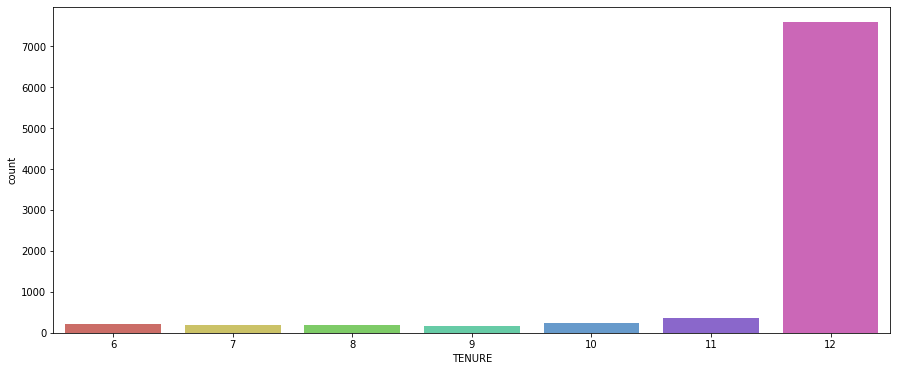

In [25]:
for i in discrete_numeric_columns:
    print('Countplot for:', i)
    plt.figure(figsize=(15,6))
    sns.countplot(x = df[i], data = df, palette = 'hls')
    plt.show()

In [27]:
for i in discrete_numeric_columns:
    fig = go.Figure(data=[go.Bar(x=df[i].value_counts().index, 
                                 y=df[i].value_counts())])
    fig.update_layout(
        title=i,
        xaxis_title=i,
        yaxis_title="Count")
    fig.show()

In statistics and data visualization, KDE (Kernel Density Estimation) and PDF (Probability Density Function) are related concepts used to estimate and visualize the probability density of a continuous random variable.

Kernel Density Estimation (KDE): Kernel Density Estimation is a non-parametric way to estimate the probability density function (PDF) of a random variable. It provides a smoother representation of the underlying probability distribution compared to traditional histograms. In KDE, a kernel (a smooth, symmetric, and usually bell-shaped function) is placed at each data point, and the overall density is obtained by summing these kernels. The bandwidth parameter controls the smoothness of the resulting density estimation.

Probability Density Function (PDF): The Probability Density Function (PDF) is a function that describes the likelihood of a continuous random variable taking a particular value. For continuous random variables, the probability of the variable falling within a specific range is given by the integral of the PDF over that range. The PDF should satisfy two conditions: it should be non-negative for all values, and the total area under the curve (over all possible values) should equal 1.

In summary, KDE is a method to estimate the PDF of a continuous random variable by smoothing the distribution using kernels, and the PDF is a mathematical function that describes the probability distribution of a continuous random variable.

In [ ]:
for i in continuous_numeric_columns:
    for j in continuous_numeric_columns:
        if i != j:
            fig = go.Figure()
            fig.add_trace(go.Scatter(x=df[j], y=df[i], mode='markers', 
                                     marker=dict(color='blue', opacity=0.6),
                                     name=f'{i} vs {j}'))
            fig.update_layout(title=f'{i} vs {j}', xaxis_title=j, yaxis_title=i)
            fig.show()

In [45]:
correlation_matrix = df.corr()

In [46]:
correlation_matrix

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
BALANCE,1.000000,0.322412,0.181261,0.164350,0.126469,0.496692,-0.077944,0.073166,-0.063186,0.449218,0.385152,0.154338,0.531296,0.322802,0.399642,-0.318959,0.072692
BALANCE_FREQUENCY,0.322412,1.000000,0.133674,0.104323,0.124292,0.099388,0.229715,0.202415,0.176079,0.191873,0.141555,0.189626,0.095931,0.065008,0.140632,-0.095082,0.119776
PURCHASES,0.181261,0.133674,1.000000,0.916845,0.679896,-0.051474,0.393017,0.498430,0.315567,-0.120143,-0.067175,0.689561,0.356977,0.603264,0.096993,0.180379,0.086288
ONEOFF_PURCHASES,0.164350,0.104323,0.916845,1.000000,0.330622,-0.031326,0.264937,0.524891,0.127729,-0.082628,-0.046212,0.545523,0.319735,0.567292,0.051151,0.132763,0.064150
INSTALLMENTS_PURCHASES,0.126469,0.124292,0.679896,0.330622,1.000000,-0.064244,0.442418,0.214042,0.511351,-0.132318,-0.073999,0.628108,0.256515,0.384084,0.135223,0.182569,0.086143
CASH_ADVANCE,0.496692,0.099388,-0.051474,-0.031326,-0.064244,1.000000,-0.215507,-0.086754,-0.177070,0.628522,0.656498,-0.075850,0.303997,0.453238,0.141491,-0.152935,-0.068312
PURCHASES_FREQUENCY,-0.077944,0.229715,0.393017,0.264937,0.442418,-0.215507,1.000000,0.501343,0.862934,-0.308478,-0.203478,0.568430,0.119833,0.103464,0.007943,0.305802,0.061506
ONEOFF_PURCHASES_FREQUENCY,0.073166,0.202415,0.498430,0.524891,0.214042,-0.086754,0.501343,1.000000,0.142329,-0.111716,-0.069088,0.544869,0.295059,0.243537,-0.025791,0.157531,0.082466
PURCHASES_INSTALLMENTS_FREQUENCY,-0.063186,0.176079,0.315567,0.127729,0.511351,-0.177070,0.862934,0.142329,1.000000,-0.262958,-0.169207,0.529975,0.060794,0.085551,0.033421,0.250087,0.073275
CASH_ADVANCE_FREQUENCY,0.449218,0.191873,-0.120143,-0.082628,-0.132318,0.628522,-0.308478,-0.111716,-0.262958,1.000000,0.799561,-0.131168,0.132608,0.183192,0.102067,-0.249773,-0.133372


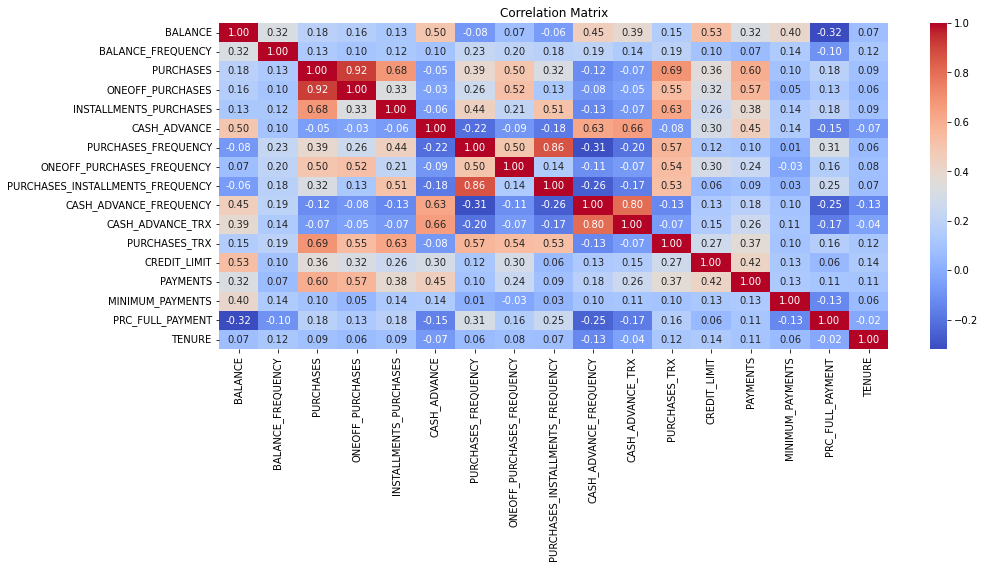

In [47]:
plt.figure(figsize=(15, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Matrix')
plt.show()

In [48]:
selected_columns = ['BALANCE', 'PURCHASES', 'CASH_ADVANCE', 'CREDIT_LIMIT', 'PAYMENTS']
fig_pairplot = px.scatter_matrix(df[selected_columns], dimensions=selected_columns,
                                  title='Pair Plot of Select Continuous Numeric Columns')
fig_pairplot.show()

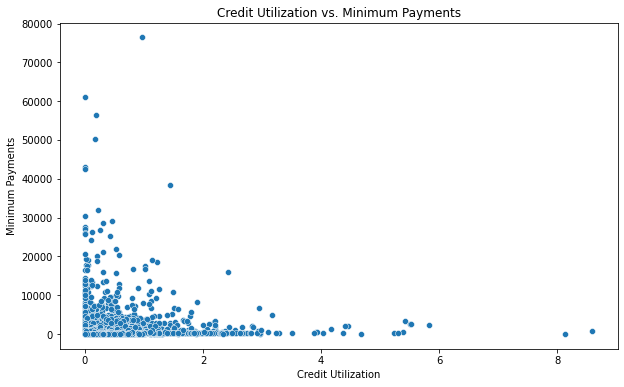

In [49]:
# Credit Utilization Analysis
df['CREDIT_UTILIZATION'] = df['PURCHASES'] / df['CREDIT_LIMIT']
plt.figure(figsize=(10, 6))
sns.scatterplot(x='CREDIT_UTILIZATION', y='MINIMUM_PAYMENTS', data=df)
plt.title('Credit Utilization vs. Minimum Payments')
plt.xlabel('Credit Utilization')
plt.ylabel('Minimum Payments')
plt.show()

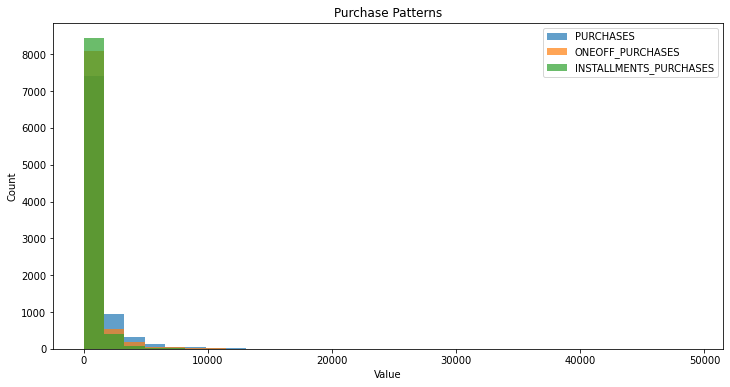

In [50]:
# Behavioral Patterns Analysis
behavioral_features = ['PURCHASES', 'ONEOFF_PURCHASES', 'INSTALLMENTS_PURCHASES']
df[behavioral_features].plot(kind='hist', bins=30, alpha=0.7, figsize=(12, 6))
plt.title('Purchase Patterns')
plt.xlabel('Value')
plt.ylabel('Count')
plt.show()

In [51]:
fig = px.histogram(df, 
                   x=behavioral_features, 
                   nbins=30, 
                   opacity=0.7, 
                   labels={'value': 'Value', 'count': 'Count'},
                   title='Purchase Patterns')

fig.update_layout(bargap=0.2)
fig.show()

In [52]:
df1 = df.copy()

In [53]:
Q1 = df1.quantile(0.10)
Q3 = df1.quantile(0.90)
IQR = Q3 - Q1

lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

df2= df1[((df1 >= lower_bound) & (df1 <= upper_bound)).all(axis=1)]

In [54]:
df2.shape

(7791, 18)

In [55]:
from sklearn.decomposition import PCA

In [56]:
X = df2.values

In [57]:
X_standardized = (X - X.mean(axis=0)) / X.std(axis=0)

In [58]:
pca = PCA()
pca.fit(X_standardized)

PCA()

In [59]:
explained_variance_ratio = pca.explained_variance_ratio_

In [60]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=np.arange(1, len(explained_variance_ratio) + 1),
                         y=np.cumsum(explained_variance_ratio),
                         mode='lines+markers',
                         name='Cumulative Explained Variance'))
fig.add_trace(go.Bar(x=np.arange(1, len(explained_variance_ratio) + 1),
                     y=explained_variance_ratio,
                     name='Explained Variance Ratio'))

fig.update_layout(title='Explained Variance Ratio by Principal Component',
                  xaxis_title='Principal Component',
                  yaxis_title='Explained Variance Ratio',
                  showlegend=True)

fig.show()

"Explained Variance" and "Cumulative Explained Variance" are essential concepts, especially when dealing with dimensionality reduction techniques such as Principal Component Analysis (PCA). Let's break down these terms:

### Explained Variance (EV) or Explained Variance Ratio (EVR):

- **Explained Variance (EV):** In the context of PCA, the explained variance is the amount of variance captured by each principal component. It tells us how much information (variance) is attributed to each of the principal components.

- **Explained Variance Ratio (EVR):** It is the proportion of the dataset's variance that lies along the axis of each principal component. For each principal component, the explained variance ratio is the ratio of the variance captured by that component to the total variance.

In mathematical terms, for a particular principal component \(i\), the explained variance ratio \(EV_i\) is calculated as:

\[ EV_i = \frac{\text{Variance along PC}_i}{\text{Total Variance}} \]

The cumulative explained variance at \(i\) principal components is the sum of explained variance ratios up to the \(i\)th component. It represents the total amount of variance captured by considering the first \(i\) principal components.

### Cumulative Explained Variance:

- **Cumulative Explained Variance:** This is the accumulated amount of variance explained by the first \(i\) principal components. It helps us understand how much of the total variance in the dataset is explained by including more principal components.

In mathematical terms, for \(i\) principal components, the cumulative explained variance \(CEV_i\) is calculated as:

\[ CEV_i = \sum_{k=1}^{i} EV_k \]

In a practical sense, it's common to plot the cumulative explained variance against the number of principal components. This plot helps in deciding how many principal components to retain for dimensionality reduction while capturing a significant portion of the dataset's variance.

The cumulative explained variance plot often shows an "elbow" point, which can help determine the optimal number of principal components to retain based on the diminishing returns of additional components in explaining the variance.

Understanding these metrics is crucial for making informed decisions about the number of principal components to keep in dimensionality reduction techniques like PCA.

In [61]:
feature_names = df2.columns

In [62]:
sorted_feature_names = [x for _, x in sorted(zip(explained_variance_ratio, feature_names), reverse=True)]

In [63]:
for i, feature in enumerate(sorted_feature_names, start=1):
    print(f"{i}. {feature}")

1. BALANCE
2. BALANCE_FREQUENCY
3. PURCHASES
4. ONEOFF_PURCHASES
5. INSTALLMENTS_PURCHASES
6. CASH_ADVANCE
7. PURCHASES_FREQUENCY
8. ONEOFF_PURCHASES_FREQUENCY
9. PURCHASES_INSTALLMENTS_FREQUENCY
10. CASH_ADVANCE_FREQUENCY
11. CASH_ADVANCE_TRX
12. PURCHASES_TRX
13. CREDIT_LIMIT
14. PAYMENTS
15. MINIMUM_PAYMENTS
16. PRC_FULL_PAYMENT
17. TENURE
18. CREDIT_UTILIZATION


In [64]:
fig_features = go.Figure(go.Bar(
    x=feature_names,
    y=pca.explained_variance_ratio_,
    text=feature_names,
    hoverinfo='x+y',
))
fig_features.update_layout(
    title='Feature Contributions to Explained Variance',
    xaxis_title='Features',
    yaxis_title='Explained Variance Ratio',
)
fig_features.show()

In [65]:
correlation_threshold = 0.5

correlation_matrix = df2.corr().abs()

high_correlation_features = []
for feature in df2.columns:
    correlated_features = correlation_matrix[feature][correlation_matrix[feature] > correlation_threshold].index.tolist()
    correlated_features.remove(feature)  # Remove self-correlation
    if correlated_features:
        high_correlation_features.append((feature, correlated_features))

for feature, correlated_features in high_correlation_features:
    print(f"Feature '{feature}' is highly correlated with: {', '.join(correlated_features)}")

Feature 'BALANCE' is highly correlated with: CASH_ADVANCE, MINIMUM_PAYMENTS
Feature 'PURCHASES' is highly correlated with: ONEOFF_PURCHASES, INSTALLMENTS_PURCHASES, PURCHASES_FREQUENCY, ONEOFF_PURCHASES_FREQUENCY, PURCHASES_TRX, CREDIT_UTILIZATION
Feature 'ONEOFF_PURCHASES' is highly correlated with: PURCHASES, ONEOFF_PURCHASES_FREQUENCY, PURCHASES_TRX, CREDIT_UTILIZATION
Feature 'INSTALLMENTS_PURCHASES' is highly correlated with: PURCHASES, PURCHASES_FREQUENCY, PURCHASES_INSTALLMENTS_FREQUENCY, PURCHASES_TRX, CREDIT_UTILIZATION
Feature 'CASH_ADVANCE' is highly correlated with: BALANCE, CASH_ADVANCE_FREQUENCY, CASH_ADVANCE_TRX
Feature 'PURCHASES_FREQUENCY' is highly correlated with: PURCHASES, INSTALLMENTS_PURCHASES, PURCHASES_INSTALLMENTS_FREQUENCY, PURCHASES_TRX, CREDIT_UTILIZATION
Feature 'ONEOFF_PURCHASES_FREQUENCY' is highly correlated with: PURCHASES, ONEOFF_PURCHASES, PURCHASES_TRX
Feature 'PURCHASES_INSTALLMENTS_FREQUENCY' is highly correlated with: INSTALLMENTS_PURCHASES, PURC

Certainly! Here's a summary of the high correlations observed among the features:

1. **BALANCE** is strongly correlated with:
   - **CASH_ADVANCE**: Reflecting a link between cash advances and account balance.
   - **MINIMUM_PAYMENTS**: Suggesting a relationship between minimum payments and account balance.

2. **PURCHASES** is highly correlated with:
   - **ONEOFF_PURCHASES**, **INSTALLMENTS_PURCHASES**: Indicating different types of purchases are correlated with total purchases.
   - **PURCHASES_FREQUENCY**, **ONEOFF_PURCHASES_FREQUENCY**: Suggesting the frequency of purchases correlates with total purchases.
   - **PURCHASES_TRX**: Showing a correlation with the number of purchase transactions.

3. **ONEOFF_PURCHASES** is highly correlated with:
   - **PURCHASES**, **ONEOFF_PURCHASES_FREQUENCY**: Indicating a link with general purchases and frequency of significant purchases.
   - **PURCHASES_TRX**: Showing a correlation with the number of purchase transactions.
   - **CREDIT_UTILIZATION**: Suggesting a relationship with credit card utilization for one-off purchases.

4. **INSTALLMENTS_PURCHASES** is highly correlated with:
   - **PURCHASES_FREQUENCY**, **PURCHASES_INSTALLMENTS_FREQUENCY**: Suggesting a link with purchase frequency and installment purchases.
   - **PURCHASES_TRX**: Showing a correlation with the number of purchase transactions.

5. **CASH_ADVANCE** is highly correlated with:
   - **BALANCE**: Reflecting a correlation with account balance.
   - **CASH_ADVANCE_FREQUENCY**, **CASH_ADVANCE_TRX**: Indicating a relationship with the frequency and number of cash advances.

6. **PURCHASES_FREQUENCY** is highly correlated with:
   - **PURCHASES**, **INSTALLMENTS_PURCHASES**, **PURCHASES_INSTALLMENTS_FREQUENCY**: Showing a link with different aspects of purchase frequency.
   - **PURCHASES_TRX**: Correlated with the number of purchase transactions.

7. **ONEOFF_PURCHASES_FREQUENCY** is highly correlated with:
   - **PURCHASES**, **ONEOFF_PURCHASES**, **PURCHASES_TRX**: Indicating a correlation with purchases and frequency of significant purchases.

8. **PURCHASES_INSTALLMENTS_FREQUENCY** is highly correlated with:
   - **INSTALLMENTS_PURCHASES**, **PURCHASES_FREQUENCY**: Suggesting a link with purchase frequency and installment purchases.
   - **PURCHASES_TRX**: Showing a correlation with the number of purchase transactions.

9. **CASH_ADVANCE_FREQUENCY** is highly correlated with:
   - **CASH_ADVANCE**, **CASH_ADVANCE_TRX**: Indicating a relationship with the frequency and number of cash advances.

10. **CASH_ADVANCE_TRX** is highly correlated with:
    - **CASH_ADVANCE**, **CASH_ADVANCE_FREQUENCY**: Showing a correlation with cash advances and their frequency.

11. **PURCHASES_TRX** is highly correlated with:
    - **PURCHASES**, **ONEOFF_PURCHASES**, **INSTALLMENTS_PURCHASES**, **PURCHASES_FREQUENCY**, **ONEOFF_PURCHASES_FREQUENCY**, **PURCHASES_INSTALLMENTS_FREQUENCY**: Indicating a strong relationship with various transactional aspects.

12. **MINIMUM_PAYMENTS** is highly correlated with:
    - **BALANCE**: Showing a relationship between account balance and minimum payments.

13. **CREDIT_UTILIZATION** is highly correlated with:
    - **PURCHASES**, **ONEOFF_PURCHASES**, **INSTALLMENTS_PURCHASES**, **PURCHASES_FREQUENCY**, **PURCHASES_TRX**: Indicating a correlation with various aspects of credit card usage.

These correlations provide valuable insights into the relationships among different features, which can be used for further analysis and segmentation in the credit card domain.

In [71]:
from sklearn.preprocessing import StandardScaler

In [66]:
df2.columns

Index(['BALANCE', 'BALANCE_FREQUENCY', 'PURCHASES', 'ONEOFF_PURCHASES',
       'INSTALLMENTS_PURCHASES', 'CASH_ADVANCE', 'PURCHASES_FREQUENCY',
       'ONEOFF_PURCHASES_FREQUENCY', 'PURCHASES_INSTALLMENTS_FREQUENCY',
       'CASH_ADVANCE_FREQUENCY', 'CASH_ADVANCE_TRX', 'PURCHASES_TRX',
       'CREDIT_LIMIT', 'PAYMENTS', 'MINIMUM_PAYMENTS', 'PRC_FULL_PAYMENT',
       'TENURE', 'CREDIT_UTILIZATION'],
      dtype='object')

In [67]:
selected_features = [
    'BALANCE',
    'PURCHASES',
    'ONEOFF_PURCHASES',
    'INSTALLMENTS_PURCHASES',
    'CASH_ADVANCE',
    'CREDIT_LIMIT',
    'PAYMENTS',
    'PRC_FULL_PAYMENT',
    'TENURE',
    'CREDIT_UTILIZATION'
]

selected_features = ['BALANCE', 'CASH_ADVANCE', 'MINIMUM_PAYMENTS', 
                     'PURCHASES', 'ONEOFF_PURCHASES', 'INSTALLMENTS_PURCHASES',
                     'PURCHASES_FREQUENCY', 'ONEOFF_PURCHASES_FREQUENCY', 
                     'PURCHASES_TRX']

In [68]:
selected_data = df2[selected_features]

In [69]:
selected_data

,BALANCE,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,CREDIT_LIMIT,PAYMENTS,PRC_FULL_PAYMENT,TENURE,CREDIT_UTILIZATION
0,40.900749,95.40,0.00,95.40,0.000000,1000.0,201.802084,0.000000,12,0.095400
1,3202.467416,0.00,0.00,0.00,6442.945483,7000.0,4103.032597,0.222222,12,0.000000
2,2495.148862,773.17,773.17,0.00,0.000000,7500.0,622.066742,0.000000,12,0.103089
3,1666.670542,1499.00,1499.00,0.00,205.788017,7500.0,0.000000,0.000000,12,0.199867
4,817.714335,16.00,16.00,0.00,0.000000,1200.0,678.334763,0.000000,12,0.013333
...,...,...,...,...,...,...,...,...,...,...
8908,21.357267,212.87,0.00,212.87,0.000000,1000.0,169.713838,1.000000,7,0.212870
8909,641.282519,750.00,750.00,0.00,0.000000,1000.0,105.582942,0.000000,7,0.750000
8910,356.108694,465.00,465.00,0.00,0.000000,1000.0,118.775188,0.000000,7,0.465000
8911,30.709172,693.42,0.00,693.42,0.000000,1000.0,1154.520085,0.000000,7,0.693420


In [72]:
scaler = StandardScaler()
scaled_data = scaler.fit_transform(selected_data)

# Data Modeling

In [73]:
from sklearn.cluster import KMeans

In [74]:
inertia = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, random_state=42)
    kmeans.fit(scaled_data)
    inertia.append(kmeans.inertia_)

Inertia: Inertia, also known as within-cluster sum of squares, is a measure of how far the points within a cluster are from the center of that cluster (centroid). It quantifies the compactness of the clusters. The lower the inertia, the better the clustering.

KMeans Clustering: KMeans is a popular clustering algorithm that partitions a dataset into 'k' distinct, non-overlapping subgroups or clusters. It aims to minimize the within-cluster variance (inertia) by iteratively reassigning data points to clusters and updating the cluster centroids.

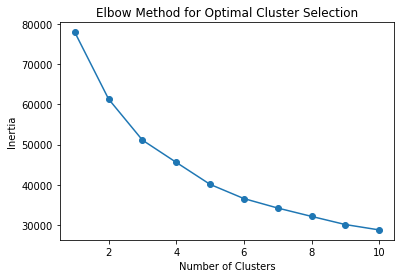

In [75]:
# Plot the Elbow Method
plt.plot(range(1, 11), inertia, marker='o')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow Method for Optimal Cluster Selection')
plt.show()

In [76]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=list(range(1, 11)), y=inertia, mode='lines+markers'))
fig.update_layout(title='Elbow Method for Optimal Cluster Selection',
                  xaxis=dict(title='Number of Clusters'),
                  yaxis=dict(title='Inertia'))
fig.show()

In [89]:
num_clusters = 2

In [90]:
kmeans = KMeans(n_clusters=num_clusters, random_state=42)
clusters = kmeans.fit_predict(scaled_data)

In [91]:
new_dfa = pd.DataFrame(data = scaled_data, columns = selected_features)
new_dfa['label_kmeans'] = clusters
new_dfa

,BALANCE,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,CREDIT_LIMIT,PAYMENTS,PRC_FULL_PAYMENT,TENURE,CREDIT_UTILIZATION,label_kmeans
0,-0.761579,-0.640756,-0.558170,-0.433457,-0.557045,-0.971777,-0.751579,-0.514748,0.342497,-0.412637,1
1,1.125736,-0.745089,-0.558170,-0.633506,4.343978,0.878420,2.065559,0.263370,0.342497,-0.755149,1
2,0.703498,0.100475,0.579188,-0.633506,-0.557045,1.032603,-0.448100,-0.514748,0.342497,-0.385030,1
3,0.208933,0.894266,1.646908,-0.633506,-0.400507,1.032603,-0.897304,-0.514748,0.342497,-0.037574,1
4,-0.297856,-0.727591,-0.534634,-0.633506,-0.557045,-0.910104,-0.407468,-0.514748,0.342497,-0.707279,1
...,...,...,...,...,...,...,...,...,...,...,...
7786,-0.773245,-0.512287,-0.558170,-0.187129,-0.557045,-0.971777,-0.774751,2.986787,-4.304653,0.009112,1
7787,-0.403177,0.075135,0.545104,-0.633506,-0.557045,-0.971777,-0.821061,-0.514748,-4.304653,1.937553,1
7788,-0.573413,-0.236550,0.125860,-0.633506,-0.557045,-0.971777,-0.811534,-0.514748,-4.304653,0.914326,1
7789,-0.767662,0.013258,-0.558170,0.820558,-0.557045,-0.971777,-0.063607,-0.514748,-4.304653,1.734416,1


In [92]:
centroids = kmeans.cluster_centers_
labels = kmeans.labels_

print('Centroids:', centroids)
print('Labels:', labels)

Centroids: [[ 0.06055136  1.64431871  1.33988061  1.24238637 -0.21224852  0.42452579
   0.76026777  0.36502704  0.15443399  1.29050506]
 [-0.01488127 -0.40411223 -0.32929269 -0.30533224  0.05216277 -0.10433261
  -0.18684547 -0.08971004 -0.03795412 -0.31715802]]
Labels: [1 1 1 ... 1 1 1]


In [93]:
fig = px.scatter(data_frame=new_dfa, x='BALANCE', y='PURCHASES', color='label_kmeans',
                 title='Customer Segmentation based on Balance and Purchases',
                 labels={'BALANCE': 'Balance', 'PURCHASES': 'Purchases'},
                 color_continuous_scale='Viridis')

fig.show()

In [94]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=new_dfa['BALANCE'], y=new_dfa['PURCHASES'], mode='markers', 
                         marker=dict(color=new_dfa['label_kmeans'], colorscale='Viridis', opacity=0.6),
                         text='Cluster ' + new_dfa['label_kmeans'].astype(str),
                         hoverinfo='text'))
fig.add_trace(go.Scatter(x=centroids[:, 0], y=centroids[:, 1], 
                         mode='markers', marker=dict(color='red', size=10, symbol='cross'),
                         name='Cluster Centroids'))
fig.update_layout(title='Customer Segmentation based on Balance and Purchases with Cluster Centroids',
                  xaxis=dict(title='Balance'),
                  yaxis=dict(title='Purchases'))
fig.show()

In [95]:
import scipy.cluster.hierarchy as sch

In [96]:
distance_matrix = sch.distance.pdist(scaled_data)

In [97]:
linkage = sch.linkage(distance_matrix, method='complete')

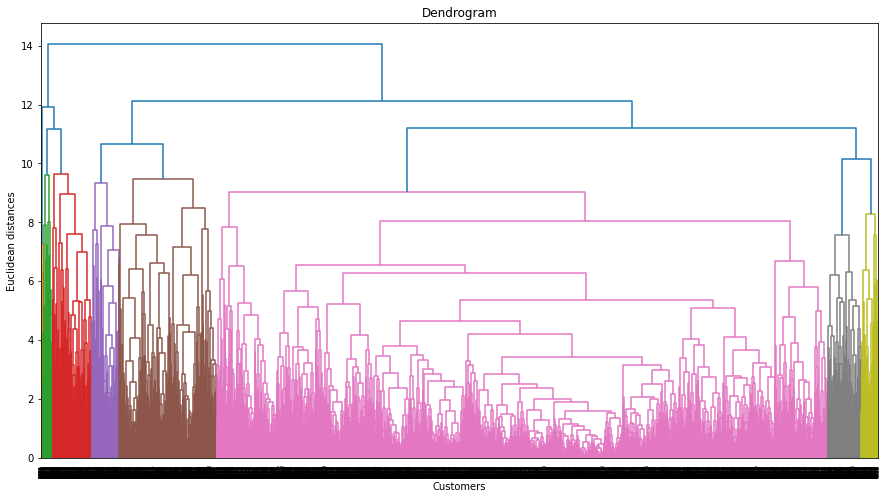

In [98]:
plt.figure(figsize=(15, 8))
plt.title('Dendrogram')
dendrogram = sch.dendrogram(linkage)
plt.xlabel('Customers')
plt.ylabel('Euclidean distances')
plt.show()

In [99]:
from sklearn.cluster import DBSCAN
dbscan = DBSCAN(eps=0.5, min_samples=5)
dbscan_labels = dbscan.fit_predict(scaled_data)

In [100]:
dbscan_labels

array([ 0, -1,  1, ..., -1, -1, -1], dtype=int64)

In [101]:
from sklearn.cluster import MeanShift
meanshift = MeanShift()
meanshift_labels = meanshift.fit_predict(scaled_data)

In [102]:
meanshift_labels

array([0, 4, 0, ..., 0, 0, 0], dtype=int64)

In [103]:
from sklearn.mixture import GaussianMixture
gmm = GaussianMixture(n_components=3)  # specify the number of components (clusters)
gmm_labels = gmm.fit_predict(scaled_data)

In [104]:
gmm_labels

array([0, 1, 2, ..., 0, 2, 2], dtype=int64)

In [105]:
from sklearn.cluster import AgglomerativeClustering
agg_clustering = AgglomerativeClustering(n_clusters=3, linkage='ward')
agg_labels = agg_clustering.fit_predict(scaled_data)

In [106]:
agg_labels 

array([0, 2, 2, ..., 0, 0, 0], dtype=int64)

In [107]:
from sklearn.cluster import OPTICS
optics = OPTICS(eps=0.5, min_samples=5)
optics_labels = optics.fit_predict(scaled_data)

In [108]:
optics_labels

array([  0,  -1, 112, ...,  -1,  -1,  -1])

# Cluster Profiling

In [109]:
cluster_centers_original = scaler.inverse_transform(kmeans.cluster_centers_)

In [110]:
cluster_centers_df = pd.DataFrame(cluster_centers_original, columns=selected_features)

In [111]:
cluster_centers_df

,BALANCE,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,CREDIT_LIMIT,PAYMENTS,PRC_FULL_PAYMENT,TENURE,CREDIT_UTILIZATION
0,1418.105819,2184.835927,1290.284593,894.583214,453.274273,5528.067763,2295.438641,0.251254,11.797658,0.569777
1,1291.743550,311.783655,155.589701,156.500747,800.872574,3813.033808,983.856947,0.121386,11.590662,0.121994


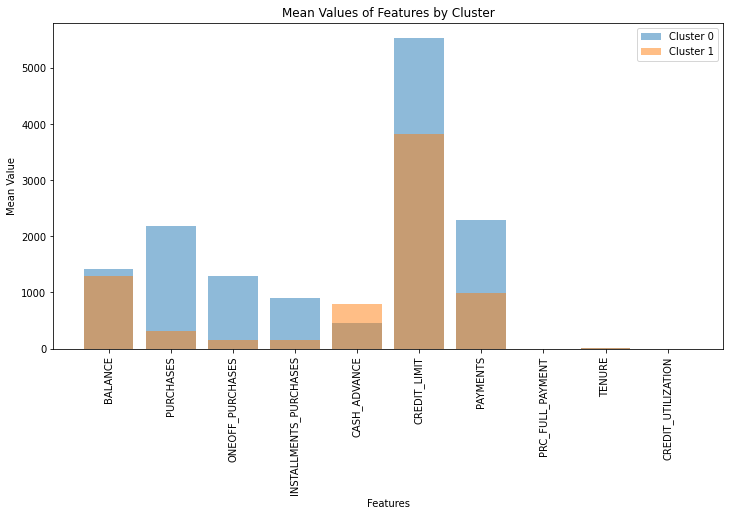

In [113]:
plt.figure(figsize=(12, 6))
for i in range(num_clusters):
    plt.bar(selected_features, cluster_centers_df.iloc[i], alpha=0.5, label=f'Cluster {i}')
plt.xlabel('Features')
plt.ylabel('Mean Value')
plt.title('Mean Values of Features by Cluster')
plt.xticks(rotation = 90)
plt.legend()
plt.show()

In [114]:
data = cluster_centers_df.transpose()  
fig = px.bar(data, 
             x=data.index, 
             y=data.columns, 
             barmode='group',
             title='Mean Values of Features by Cluster',
             labels={'x': 'Features', 'y': 'Mean Value'},
             category_orders={"x": selected_features},
             width=800, height=400)
fig.update_xaxes(tickangle=45)
fig.show()

In [115]:
for i in range(num_clusters):
    print(f"\nCluster {i} Characteristics:")
    for feature, centroid_value in zip(selected_features, cluster_centers_df.iloc[i]):
        print(f"- {feature}: {centroid_value:.2f}")


Cluster 0 Characteristics:
- BALANCE: 1418.11
- PURCHASES: 2184.84
- ONEOFF_PURCHASES: 1290.28
- INSTALLMENTS_PURCHASES: 894.58
- CASH_ADVANCE: 453.27
- CREDIT_LIMIT: 5528.07
- PAYMENTS: 2295.44
- PRC_FULL_PAYMENT: 0.25
- TENURE: 11.80
- CREDIT_UTILIZATION: 0.57

Cluster 1 Characteristics:
- BALANCE: 1291.74
- PURCHASES: 311.78
- ONEOFF_PURCHASES: 155.59
- INSTALLMENTS_PURCHASES: 156.50
- CASH_ADVANCE: 800.87
- CREDIT_LIMIT: 3813.03
- PAYMENTS: 983.86
- PRC_FULL_PAYMENT: 0.12
- TENURE: 11.59
- CREDIT_UTILIZATION: 0.12


In [116]:
segment_descriptions = [
    "Segment 0: These customers have a moderate balance, make regular purchases, and use credit moderately.",
    "Segment 1: These customers have a high balance, make frequent purchases, and utilize credit extensively.",
]

In [117]:
print("\nSegment Descriptions:")
for description in segment_descriptions:
    print(description)


Segment Descriptions:
Segment 0: These customers have a moderate balance, make regular purchases, and use credit moderately.
Segment 1: These customers have a high balance, make frequent purchases, and utilize credit extensively.


In [120]:
segment_recommendations = {
    0: "Recommendation for Segment 0: Encourage customers to make more regular purchases to maximize their credit benefits. Offer personalized product suggestions based on their purchase history.",
    1: "Recommendation for Segment 1: Leverage targeted marketing campaigns to promote high-end products or credit limit upgrades, considering their high credit utilization and purchase frequency.",
}

In [121]:
print("Tailored Recommendations:")
for segment, recommendation in segment_recommendations.items():
    print(f"\nSegment {segment} Recommendations:")
    print(recommendation)

Tailored Recommendations:

Segment 0 Recommendations:
Recommendation for Segment 0: Encourage customers to make more regular purchases to maximize their credit benefits. Offer personalized product suggestions based on their purchase history.

Segment 1 Recommendations:
Recommendation for Segment 1: Leverage targeted marketing campaigns to promote high-end products or credit limit upgrades, considering their high credit utilization and purchase frequency.


In [122]:
import pickle

kmeans_model_file = "kmeans_model.pkl"

with open(kmeans_model_file, "wb") as file:
    pickle.dump(kmeans, file)

print("K-means model saved successfully.")

K-means model saved successfully.


In [125]:
import streamlit as st

In [126]:
streamlit_version = st.__version__
print("Streamlit version:", streamlit_version)

pandas_version = pd.__version__
print("Pandas version:", pandas_version)

Streamlit version: 1.12.2
Pandas version: 1.4.3


In [127]:
import sklearn
sklearn_version = sklearn.__version__
print("scikit-learn version:", sklearn_version)

scikit-learn version: 1.1.2
